# QIMR Workshop: 001-clustering-cell-typing   

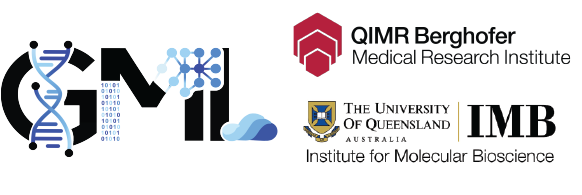

**This script has been generated by Andrew Causer from the *Genomics and Machine Learning Lab*:** 
* **Data used below is currently not published or publically available. For more information about the scripts or for the use of this datasets beyond this tutorial please contact uqacause@uq.edu.au**
* **Code and *conda* environments used are available from https://github.com/GMLTestLab/qimr-teaching** 

<br>


[QIMR Workshop](#QIMR-Workshop)<br>
&nbsp; &nbsp; [1. Data Pre-Processing](#1.-Data-Pre-Processing)<br>
&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;[Import Libraries](#Import-Libraries)<br>
&nbsp; &nbsp; &nbsp; &nbsp;   &nbsp; &nbsp;     [Load Data](#Load-Data)<br>
&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;       [Plot Data](#Plot-Data)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Seurat Object Structure](#Seurat-Object-Structure)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Visium Pre-Processing](#Visium-Pre-Processing)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Normalising Visium Data](#Normalising-Visium-Data)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Xenium Pre-Processing](#Xenium-Pre-Processing)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Xenium Normalisation](#Xenium-Normalisation)<br>
&nbsp; &nbsp; &nbsp;   [2. Clustering and Cell Typing](#2.-Clustering-and-Cell-Typing)<br>
&nbsp; &nbsp;  &nbsp; &nbsp;  &nbsp; &nbsp;     [Run PCA Visium](#Run-PCA-Visium)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Run FindNeighbors and FindClusters](#Run-FindNeighbors-and-FindClusters)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [RunUMAP](#RunUMAP)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Run Xenium Clustering](#Run-Xenium-Clustering)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Cell Typing](#Cell-Typing)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Marker Gene Based Cell Typing](#Marker-Gene-Based-Cell-Typing)<br>
&nbsp; &nbsp; &nbsp; &nbsp;  &nbsp; &nbsp;      [Database Matching of DEGs](#Database-Matching-of-DEGs)<br>
&nbsp; &nbsp; &nbsp;     [3. Spot Deconvolution/Cell Label Transfer](#3.-Spot-Deconvolution/Cell-Label-Transfer)<br>
&nbsp; &nbsp;  &nbsp; &nbsp;  &nbsp; &nbsp;     [Visium Deconvolution: CARD](#Visium-Deconvolution%3A-CARD)<br>
&nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp;       [Xenium Label Transfer](#Xenium-Label-Transfer)<br>

This workshop will demonstrate common bioinformatic analyses performed on Visium and Xenium data. This script will use various *R* based packages to expore and analyse QIMR generated melanoma skin data. Note: Visium and Xenium samples are two serial sections from the same sample

|  Data Type  | Tissue Region   |       
| :----:      |     :----:              |
| scRNA       | scRNA melanoma dataset | 
| Visium      | 10X Visium FFPE Melanoma Skin Section|
| Xenium      | 10X Xenium FFPE Melanoma Skin Section| 

<br>
<br>

This script has been generated by Andrew Causer from the **Genomics and Machine Learning Lab**: 
* For more information about the scripts or datasets please contact uqacause@uq.edu.au
* Code and *conda* environments used are available from https://github.com/GMLTestLab/qimr-teaching 

This Tutorial will be broken up into 3 major topics

1. Data Pre-Processing
2. Clustering and Cell Typing
3. Visium Deconvolution and Xenium Label Transfer

## 1. Data Pre-Processing

This section will cover how to load, process and perform QC on both Visium and Xenium datasets. First we will explain the how each dataset is structured and stored when working in *R*. After some exploration of the data structure we will then remove outlying spots/cells and lowly observed genes. The final step will be normalisation of the data, which will then provide us with a normalised and cleaned data object that we can perform various downstream analyses on. 


#### Import Libraries 

First we need to load in the *R* packages/libraries we will be using for our analysis

In [1]:
# If not installed run code below, or visit website for more info: https://satijalab.org/seurat/articles/install.html
#remotes::install_github("satijalab/seurat", "seurat5", quiet = TRUE) 

library(Seurat)
library(ggplot2)
library(dplyr)
library(CARD)

Loading required package: SeuratObject

Loading required package: sp

‘SeuratObject’ was built with package ‘Matrix’ 1.6.4 but the current
version is 1.6.5; it is recomended that you reinstall ‘SeuratObject’ as
the ABI for ‘Matrix’ may have changed


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Registered S3 methods overwritten by 'registry':
  method               from 
  print.registry_field proxy
  print.registry_entry proxy

Warning message:
“replacing previous import ‘RcppML::nmf’ by ‘NMF::nmf’ when loading ‘CARD’”


#### Load Data

Now that we have our packages installed and loaded we can import our data that we will be using for this tutorial

In [2]:
## Load Visium Data
visium <- readRDS("/working/joint_projects/P3903/teaching2024-winter-qimr/data/finalised_files_to_move/visium.RDS")

## Load Xenium Data
xenium <- readRDS("/working/joint_projects/P3903/teaching2024-winter-qimr/data/finalised_files_to_move/xenium.RDS")

### For loading the full dataset run the following code
#visium <- Load10X_Spatial(...)
#xenium <- LoadXenium("...", fov = "fov")

#### Plot Data

Now that our data is loaded we can have a look at the two dataset by plotting the results. In *R* the most convenient package for analysising Spatial Data is *Seurat*. This package can efficently store and handel large datasets, and has many easy functions for plotting and running different analyses. 


Here is a figure which will help explain the structure of seurat objects, and how they work for both Visium (sequencing-based) and Xenium (imaging based) datasets


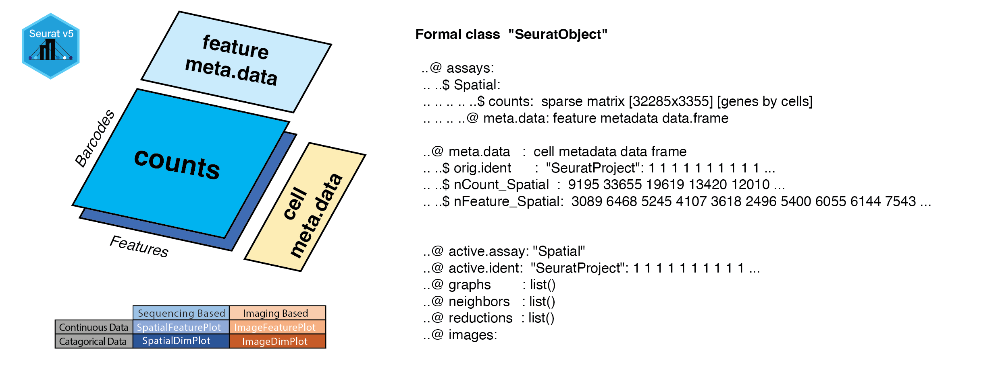


You can see in the first image the structure of an assay -> this involves multiple slots, containing data.frames/tables that store different types of data such as raw gene expression counts ('counts'), gene meta.data ("feature meta.data), and has the ability to add additional slots such as normalised and scaled expression counts ('data' and 'scaled.data' respectively -> dark blue box). 

A more detailed structure is depicted on the left which explains all the different slots and storage buckets involved in a *Seurat* object. This will come in handy for later/down stream analyses. 

Finally, the table displays the different nomenclature used when plotting image or sequence based data, along with also the type of data being plotted. For example if we are plotting gene expression this is a continuous value compared to cluster/cell type labels which are catagorical data.


<br>

Lets use *Seurat* to plot the Visium and Xenium Data

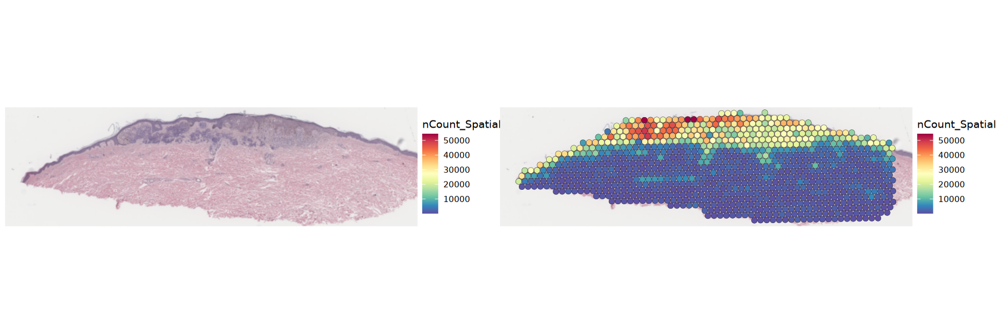

In [3]:
options(repr.plot.width = 15, repr.plot.height = 5) #helps us change the view size of plots in this notebook

SpatialFeaturePlot(visium, features = "nCount_Spatial", pt.size.factor = 1.2, alpha = 0) + theme_void() | SpatialFeaturePlot(visium, features = "nCount_Spatial", pt.size.factor = 1.2) + theme_void()

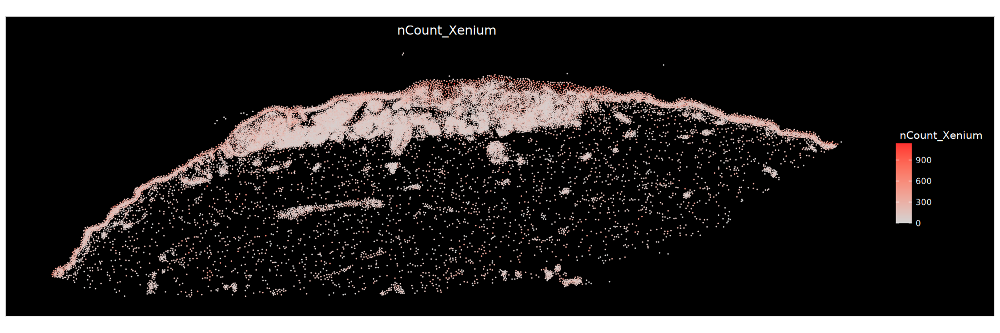

In [4]:
ImageFeaturePlot(xenium, features = "nCount_Xenium", dark.background = T)

The plots above are showing 'nCounts' which is the total number of reads present in each spot or cell. 

The major difference between Visium vs Xenium data is the trade-off between cellular resolution vs sequencing depth. 
* Visium data has a very high sequencing depth allowing us to access ~18,000 genes across every 'spot'. However, each 'spot' is a combination of ~2-10 cells.
* Xenium data is at single cell resolution, meaning we have expression values for every single cell. However, we only have access to ~300 genes which are chosen based on the relative 10X imaging panel used

Due to these limitations of both technologies it is useful to analyses them together as they complement each other. 

#### Seurat Object Structure

Let's look at the data slots for both our Visium and Xenium Objects

In [5]:
cat("Visium Object ... ")
visium

cat("\nXenium Object ... ")
xenium

Visium Object ... 

An object of class Seurat 
18085 features across 923 samples within 1 assay 
Active assay: Spatial (18085 features, 0 variable features)
 1 layer present: counts
 1 image present: slice1


Xenium Object ... 

An object of class Seurat 
541 features across 21596 samples within 4 assays 
Active assay: Xenium (260 features, 0 variable features)
 1 layer present: counts
 3 other assays present: BlankCodeword, ControlCodeword, ControlProbe
 1 spatial field of view present: fov

Based on this readable output we can see the number of features and genes that our Visium and Xenium Data has:

|  Data Type  | #Spots/Cells       |     #Genes     |
| :----:      |     :----:              |  :----:       |
| Visium      | 923   | 18,085 |
| Xenium      | 21,596 |  260  |

we can also see some other key information: 

|  Data Type  | Active Assay Name       |     Present Assay Layers   | Spatial Data Location |
| :----:      |     :----:              |  :----:       | :----:|
| Visium      | "Spatial"  | "counts" | image: 'slice1'|
| Xenium      | "Xenium" |  "counts" | field of view (fov): 'fov'|

<br>

This information is important because it tells us how to access the correct slot where our data of interest is stored (i.e. raw gene expression matrix, sample metadata, image coordinates)

Lets look at our gene expression first -> this is stored in the $counts slot within the default assay (Visium defaultAssay = "Spatial", Xenium defaultAssay = "Xenium") 

In [6]:
## lets look at the first 10 rows and columns of each counts mtx

cat ("Visium counts matrix")
visium@assays$Spatial$counts[1:10, 1:10]

cat ("\nXenium counts matrix")
xenium@assays$Xenium$counts[1:10, 1:10]

Visium counts matrix

  [[ suppressing 10 column names ‘AACACGTGCATCGCAC-1’, ‘AACAGGAAGAGCATAG-1’, ‘AACATCTAATGACCGG-1’ ... ]]



10 x 10 sparse Matrix of class "dgCMatrix"
                             
SAMD11   . . . .  . . . . . .
NOC2L    . . . .  1 . . 1 . .
KLHL17   . . . .  . . . . 1 .
PLEKHN1  . . . .  8 . . . . .
PERM1    . . . .  . . . . . .
HES4     . . . 1  6 . . . 1 .
ISG15    . . . .  . . . . . .
AGRN     . . . 1 19 2 . . . 1
RNF223   . . . .  . . . . . .
C1orf159 . . . .  2 . . 1 . .


Xenium counts matrix

  [[ suppressing 10 column names ‘aaaanabd-1’, ‘aaagncnp-1’, ‘aaahjphg-1’ ... ]]



10 x 10 sparse Matrix of class "dgCMatrix"
                               
ACER1   . . . .  .  .  . .  . .
ACTA2   . . . .  .  .  . .  . .
ADAM12  . . . .  .  .  . .  . .
AHNAK2  . . . .  .  .  1 .  . .
AIF1    . . . .  2  1  . 1  2 .
AKR1C1  . . . .  .  .  . .  1 .
ALOX5AP . . . .  .  .  . .  . .
APCDD1  . . . . 21 13 11 4 18 7
APOD    . . . .  2  3  5 1  1 2
AQP1    . . . .  2  2 23 2 16 3

We can see that we have our gene names as rows and our cell/spots are columns. We can also see that the values are integers so the data has not been normalised yet (these are raw counts). Lets look at the metadata now!

In [7]:
## Lets look at the @meta.data slot now. This is where metadata for each cell/spot is stored
## lets look at the first 6 rows

cat ("Visium meta.data table")
head(visium@meta.data)

cat ("Xenium meta.data table")
head(xenium@meta.data)

Visium meta.data table

,orig.ident,nCount_Spatial,nFeature_Spatial
,<fct>,<dbl>,<int>
AACACGTGCATCGCAC-1,SeuratProject,980,717
AACAGGAAGAGCATAG-1,SeuratProject,1003,715
AACATCTAATGACCGG-1,SeuratProject,1466,1005
AACATGCGCAAGTGAG-1,SeuratProject,2356,1688
AACCAGAATCAGACGT-1,SeuratProject,44942,8952
AACCATCGGAAGCGAC-1,SeuratProject,4309,2807


Xenium meta.data table

,orig.ident,nCount_Xenium,nFeature_Xenium,nCount_BlankCodeword,nFeature_BlankCodeword,nCount_ControlCodeword,nFeature_ControlCodeword,nCount_ControlProbe,nFeature_ControlProbe
,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>
aaaanabd-1,SeuratProject,5,4,0,0,0,0,0,0
aaagncnp-1,SeuratProject,8,7,0,0,0,0,0,0
aaahjphg-1,SeuratProject,2,2,0,0,0,0,0,0
aaaipkle-1,SeuratProject,2,2,0,0,0,0,0,0
aaajabff-1,SeuratProject,252,61,0,0,0,0,0,0
aaajjcmo-1,SeuratProject,188,56,0,0,0,0,0,0


We can see that for Visium data we have barcodes as the rownames which represent the barcode sequence. Whereas for xenium data, each cell has a unique name represented by this code. In addition, the @meta.data slot stores important information including the number of reads (nCount_Spatial/nCount_Xenium) and the number of genes (nFeature_Spatial/nFeature_Xenium) within each spot/cell. 


Now that we have loaded in our data we will perform some general exploratory sample processing 

#### Visium Pre-Processing

First we will process our Visium data. Visium data is mainly susceptible to sequencing based technical noise, meaning that sequening depth across data points, between different arrays can vary. To control for this we implement two main steps:

1. Removing outlying data spots and genes
2. Normalising for sequencing depth difference between spots


*Removing outlying data spots and Genes*
* Generally we consider a spot as an outlier if its counts diverge from the general distribution of the dataset as a whole. In otherwords, If a spot has excessively high or low number of total reads compared to all other spots we will remove it.
* In addition, spots can be considered outliers if they have excessively high levels of mitochondrial content, as this suggests the cells could be dead/dying cells. NOTE: Some diseases (such as cancer) have high levels of MT reads so it is important to check, before setting a threshold to filter out spots. 
* Similarly, genes are removed if they are rarely expressed. As a general rule of thumb, we assume a gene must be expressed in at least 3 cells to be classified as a valid gene. This threshold is rather arbitrary, but is based of lack of statistical power when performing differential gene expression analysis

To determine the best thresholds to use for our dataset, we can use some general plots to visualise the distribution of total reads, genes and percentage of mitochondrial genes per spot.

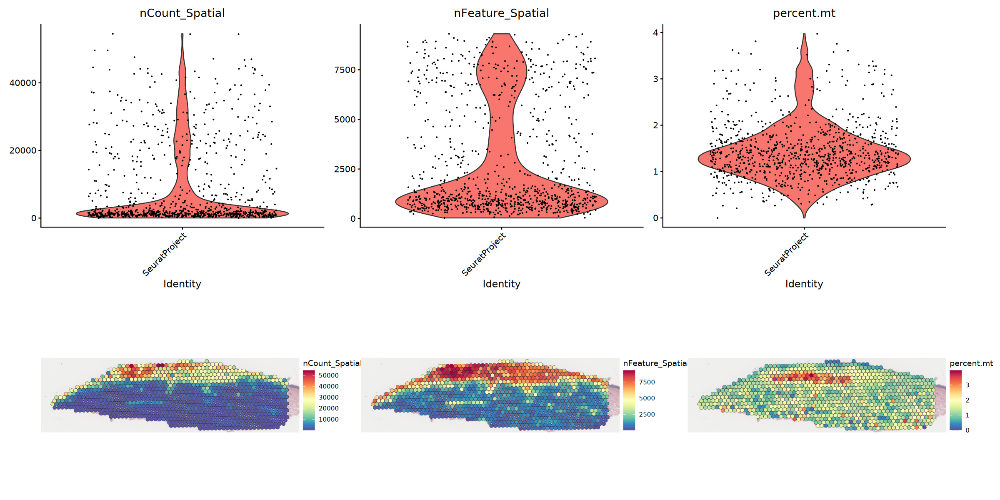

In [8]:
# Quantifies the percentage of mt genes per spot
visium@meta.data$percent.mt <- PercentageFeatureSet(visium, pattern = "^MT-")

# Plot vln plots 
vlnplots <- VlnPlot(visium, features = c("nCount_Spatial","nFeature_Spatial", "percent.mt"), layer = "counts", pt.size = 0.1) & NoLegend()
sptplots <- SpatialFeaturePlot(visium, features = c("nCount_Spatial","nFeature_Spatial", "percent.mt"), pt.size.factor = 1.2) & theme_void() & theme(legend.position = "right") # "& theme()" is a way of changing the plot layout seetings to improve visualisation

# Visualise plots
options(repr.plot.width = 20, repr.plot.height = 10)

vlnplots/sptplots

We can see that the majority of spots have ~ 10,000 counts and 2,500 genes. We can also see that this sample has a maximum of 4% MT content which is not abnormal. A common threshold to use is often ~20% but will change depending on the sample. 

Now we can filter our data and see which spots have been removed, we will also filter lowly observed genes too. 

In [9]:
# Remove outlyer spots 
visium <- subset(visium, subset = nCount_Spatial > 200)

# Remove lowly observed genes
selected_genes <- rownames(visium)[Matrix::rowSums(visium@assays$Spatial$counts > 0) >= 3] # gets list of genes that are expressed in atleast 3 cells/spots

visium <- subset(visium, features = selected_genes)

Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Seurat objects”


We can now visualised the QC results

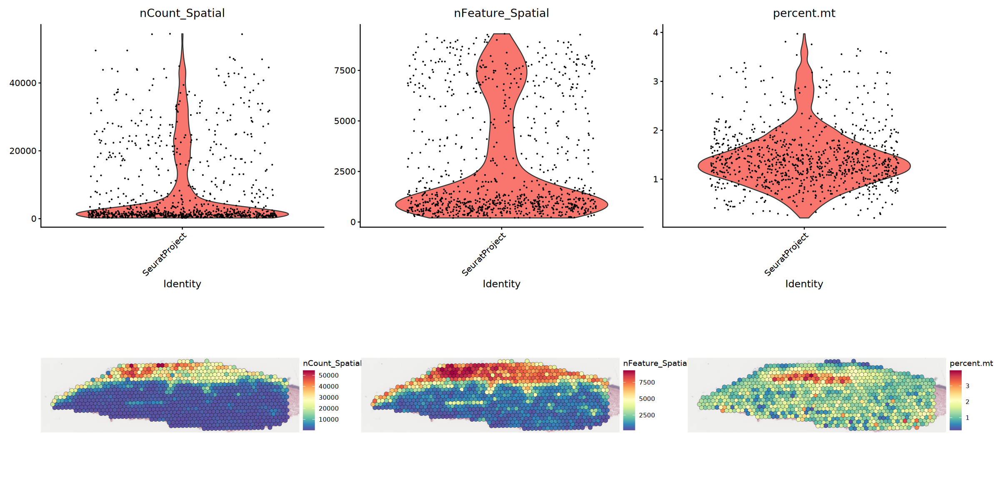

In [10]:
# Plot vln plots 
vlnplots <- VlnPlot(visium, features = c("nCount_Spatial","nFeature_Spatial",  "percent.mt"), layer = "counts", pt.size = 0.1) & NoLegend()
sptplots <- SpatialFeaturePlot(visium, features = c("nCount_Spatial","nFeature_Spatial",  "percent.mt"), pt.size.factor = 1.4) & theme_void() &theme(legend.position = "right")

# Visualise plots
options(repr.plot.width = 20, repr.plot.height = 10)

vlnplots/sptplots

In [11]:
visium

An object of class Seurat 
15155 features across 917 samples within 1 assay 
Active assay: Spatial (15155 features, 0 variable features)
 1 layer present: counts
 1 image present: slice1

We can see that we now have ~15,000 genes instead of ~18,000; and 6 spots were removed, now having 917 compared to 923. 

The next step is normalisation:

#### Normalising Visium Data

Normalisation is an import process that allows us to control for differences in sequencing depth across a sample. Similar to traditional single-cell approaches normalisation is required to ensure gene expression values are not skewed when calculating genes that are differentially expressed between different groups of spots/cells.

The classical way of normalising scRNA and also Spatial data was to use a technique called library size normalisation (read here for more info: https://bioconductor.org/books/3.17/OSCA.basic/normalization.html). The aim is to scale the data by a "library size factor" which results in each spot being directly proportional to the library size of each spot. For example: if the expression of GeneA is 10 in one spot and the library size of that spot is 20, compared to another spot where the expression of the GeneA is 10 but the library size is 1000, then the normalised expression level of GeneA is spot 2 would be much lower than the normalised expression level of GeneA in spot 1. This however has some limitations, as this approach assumes that all spots/cells should have the same sequencing depth/library size. This would not be true though if we were comparing tumour cells which have a high level of gene expression by nature compared to adipocytes which has relatively low number of genes expressed comparably. 


The alternative approach is to use a method such as *SCTransfrom*. SCTransform is a more advanced method that provides normalization, variance stabilization, and batch effect correction in one step using a regularized negative binomial regression model. This function works by:
* Modelling Counts: Fits a generalized linear model (GLM) to each gene's counts using a negative binomial distribution.
* Variance Stabilization: Estimates the mean-variance relationship and transforms the data to stabilize variance across genes. This transformation adjusts the data such that the variance becomes approximately constant across the mean expression levels. This is important as genes with higher mean expression levels tend to have higher variance (this many not be biological though), so when trying to identify differentially expressed genes, without variance stabilisation it would be hard to tell if the variance within a gene is technical or biological. The relationship between the mean and the variance is then modelled for a more accurate estimation of biological variability. 
* Normalization: Adjusts for differences in sequencing depth and other technical factors.

If you would like to read more about the underlying mathematics and statistics behind this function see here: https://genomebiology.biomedcentral.com/articles/10.1186/s13059-019-1874-1 
                                                                                                                      
SCTransfrom tends to be the most common and suitable approach for normalisation Spatial Data, so we will implement that function below                                                                                                                      
                                                                                                                                                                                                                

In [12]:
visium <- SCTransform(visium, assay = "Spatial", verbose = TRUE) # if you dont want to see the function messages printed below set verbose = FALSE

Running SCTransform on assay: Spatial

Running SCTransform on layer: counts

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 14603 by 917

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 917 cells

Found 172 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 14603 genes

Computing corrected count matrix for 14603 genes

Calculating gene attributes

Wall clock passed: Time difference of 11.0154 secs

Determine variable features

Centering data matrix

Set default assay to SCT



In [13]:
visium

An object of class Seurat 
29758 features across 917 samples within 2 assays 
Active assay: SCT (14603 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 1 image present: slice1

We can now see that our data object has been normalised and a new assay has been created to store the normalised expression values. This assay is called "SCT", which contains 3 slots -> counts, data and scale.data

<br>

|  Data Slot  | Definition      |
| :----:      |     :----:      |
| counts      | stores the raw gene expression counts after normalisation but before transformation (integers) | 
| data      | stores the transformed gene expression data which have undergone normalisation, variance stabilisation, and scaling (This is the data we used for plotting/calculating DE genes)| 
| scale.data      | stores the Pearson residuals from the regression model  | 

<br>

Let check how the data has changed between raw vs normalised

In [14]:
## lets look at the first 10 rows and columns of each counts mtx (raw vs normalised)

cat ("Raw counts matrix")
visium@assays$Spatial$counts[1:10, 1:10]

cat ("\nSCT counts matrix")
visium@assays$SCT$counts[1:10, 1:10]

cat ("\nSCT data matrix")
visium@assays$SCT$data[1:10, 3:5]

Raw counts matrix

  [[ suppressing 10 column names ‘AACACGTGCATCGCAC-1’, ‘AACAGGAAGAGCATAG-1’, ‘AACATCTAATGACCGG-1’ ... ]]



10 x 10 sparse Matrix of class "dgCMatrix"
                             
SAMD11   . . . .  . . . . . .
NOC2L    . . . .  1 . . 1 . .
KLHL17   . . . .  . . . . 1 .
PLEKHN1  . . . .  8 . . . . .
PERM1    . . . .  . . . . . .
HES4     . . . 1  6 . . . 1 .
ISG15    . . . .  . . . . . .
AGRN     . . . 1 19 2 . . . 1
RNF223   . . . .  . . . . . .
C1orf159 . . . .  2 . . 1 . .


SCT counts matrix

  [[ suppressing 10 column names ‘AACACGTGCATCGCAC-1’, ‘AACAGGAAGAGCATAG-1’, ‘AACATCTAATGACCGG-1’ ... ]]



10 x 10 sparse Matrix of class "dgCMatrix"
                            
SAMD11   . . . . . . . . . .
NOC2L    . . . . . . . 1 . .
KLHL17   . . . . . . . . . .
PLEKHN1  . . . . 1 . . . . .
PERM1    . . . . . . . . . .
HES4     . . . 1 1 . . . . .
ISG15    . . . . . . . . . .
AGRN     . . . 1 2 1 . . . 2
RNF223   . . . . . . . . . .
C1orf159 . . . . . . . 1 . .


SCT data matrix

10 x 3 sparse Matrix of class "dgCMatrix"
         AACATCTAATGACCGG-1 AACATGCGCAAGTGAG-1 AACCAGAATCAGACGT-1
SAMD11                    .          .                  .        
NOC2L                     .          .                  .        
KLHL17                    .          .                  .        
PLEKHN1                   .          .                  0.6931472
PERM1                     .          .                  .        
HES4                      .          0.6931472          0.6931472
ISG15                     .          .                  .        
AGRN                      .          0.6931472          1.0986123
RNF223                    .          .                  .        
C1orf159                  .          .                  .        

We can see here how each of the matrices differs. Compared to our raw counts, the SCT $counts slot has our adjusted counts based on the sequencing depth. Whereas the data slot has the transformed values after normalisation (using the SCTransform model) has been completed.


When running SCTransform 3000 variable features are calculated -> these represent the top 3000 most highly variable genes expressed across cells. These genes are often the most informative for defining different cell types. These will be useful in the next step, but for now we can plot them to see what the top 10 features are. 

When using repel, set xnudge and ynudge to 0 for optimal results



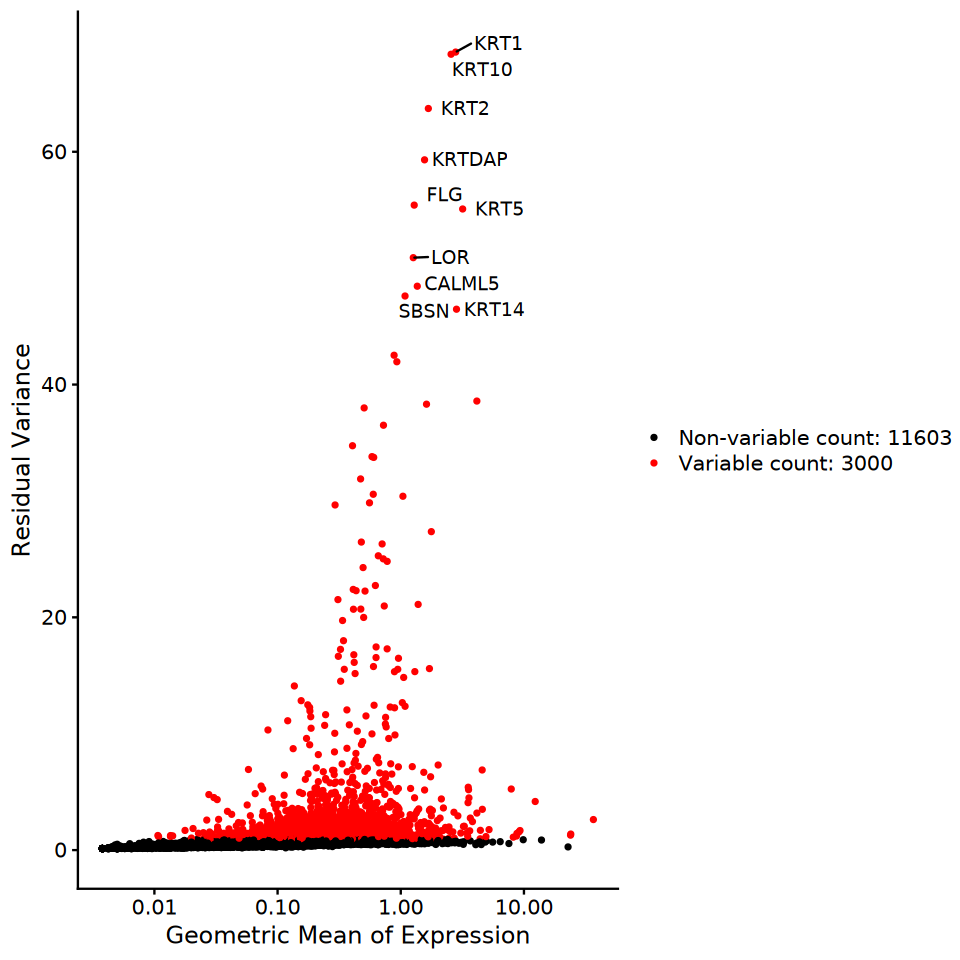

In [15]:
options(repr.plot.width = 8, repr.plot.height = 8)

plot1 <- VariableFeaturePlot(visium)
LabelPoints(plot = plot1, points = head(VariableFeatures(visium), 10), repel = TRUE)

We can see one of the top variable genes is KRT1. Lets look at this feature spatially along with another gene that's not in our top variable feature list like HES4, and see how they differ before/after normalisation

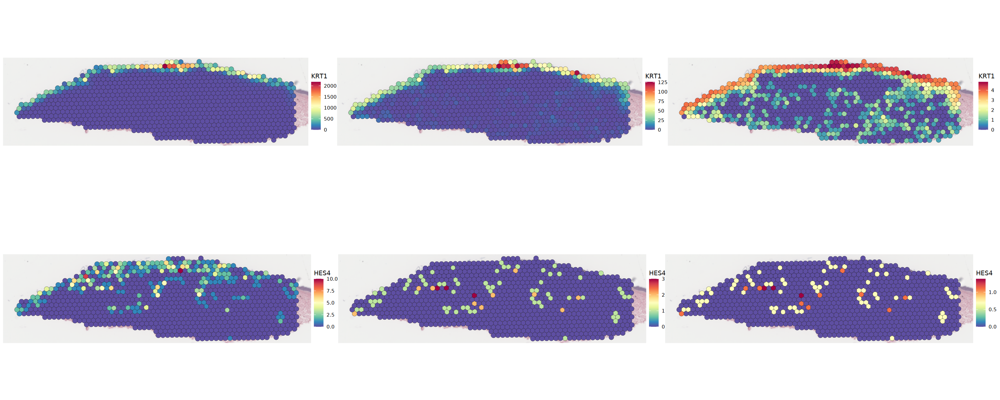

In [16]:
DefaultAssay(visium) <- "Spatial" #This is how we select what assay we want to use

raw_count_plot_DCD <- SpatialFeaturePlot(visium, features = "KRT1", slot = "counts", pt.size.factor = 1.4) + theme_void()
raw_count_plot_HES4 <- SpatialFeaturePlot(visium, features = "HES4", slot = "counts", pt.size.factor = 1.4) + theme_void()

DefaultAssay(visium) <- "SCT" 
sct_count_plot_DCD <- SpatialFeaturePlot(visium, features = "KRT1", slot = "counts", pt.size.factor = 1.4) + theme_void()
sct_data_plot_DCD <- SpatialFeaturePlot(visium, features = "KRT1", slot = "data", pt.size.factor = 1.4) + theme_void()

sct_count_plot_HES4 <- SpatialFeaturePlot(visium, features = "HES4", slot = "counts", pt.size.factor = 1.4) + theme_void()
sct_data_plot_HES4 <- SpatialFeaturePlot(visium, features = "HES4", slot = "data", pt.size.factor = 1.4) + theme_void()

# print plots
options(repr.plot.width = 25, repr.plot.height = 10)

(raw_count_plot_DCD |sct_count_plot_DCD|sct_data_plot_DCD)/
(raw_count_plot_HES4 |sct_count_plot_HES4|sct_data_plot_HES4)

Here we can see that "KRT1" (our top most variable gene), displays quite similar expression pattern between the normalised and raw data. Highlighting that SCT transformation has maintained the biological variance of this gene. 

Alternatively, when examining a non-variable gene, we notice a distinct difference between the raw and normalized data. The raw expression data shows a pattern along the epidermis, which is much less evident in the normalized data. This discrepancy is likely due to the higher sequencing depth associated with the epidermis compared to other layers. The epidermis contains a larger number of cells and, consequently, a greater amount of genetic material, which leads to a higher sequencing depth across all genes. Therefore, the observed expression pattern in the raw data might be more reflective of the sequencing depth rather than true biological variability.


#### Xenium Pre-Processing

Xenium Pre-Processing is slightly different to Visium data, because count data is generated using an imaging-based method. Because Xenium is also single cell resolution it means that the number of transcripts within a cell are quite accurate, but because we only have a few genes (~500) the number of counts/genes within each cell is much lower. But we can still implement similar functions used in the Visium preprocessing to perform QC on our Xenium data. 

First, we will remove all cells that have 0 counts within them. 

Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”


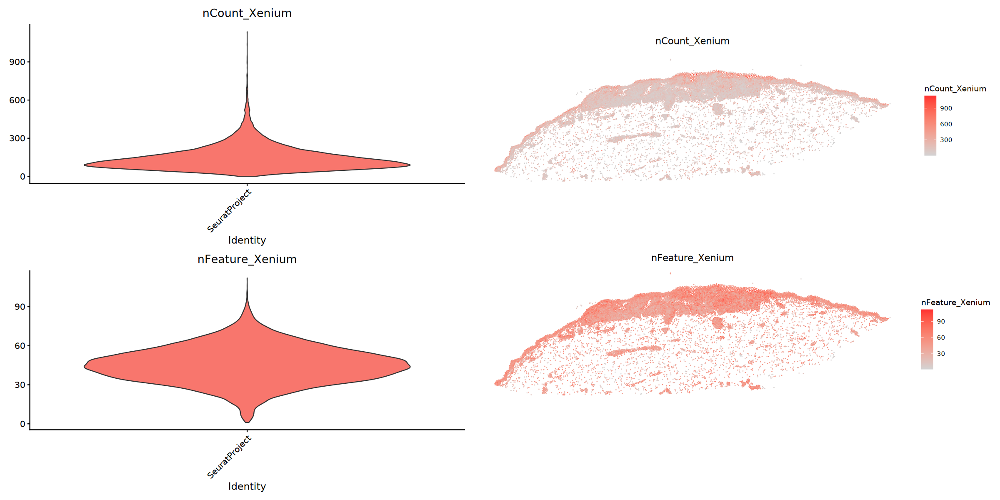

In [17]:
options(repr.plot.width = 20, repr.plot.height = 10)

# remove cells with 0 counts
xenium <- subset(xenium, subset = nCount_Xenium > 0)

# Plot vln plots 
vlnplots <- VlnPlot(xenium, features = c("nCount_Xenium","nFeature_Xenium"), layer = "counts", pt.size = 0, ncol = 1) & NoLegend()
sptplots1 <- ImageFeaturePlot(xenium, features = c("nCount_Xenium"), dark.background = F) & theme(legend.position = "right")
sptplots2 <- ImageFeaturePlot(xenium, features = c("nFeature_Xenium"), dark.background = F) & theme(legend.position = "right")

# Visualise plots
options(repr.plot.width = 20, repr.plot.height = 10)

vlnplots|(sptplots1/sptplots2)

Because this is Xenium data and there are only a few genes selected in the run panel, the number of genes expected in each cell is much lower and can even be 1. Also because the genes used in the panel are highly tested by 10X for cell typing, and there are a large number of cells, it is unlikely that we will observe any lowly observed genes. This means that filtering xenium data based on these parameters is not overly necessary, however the code below shows you how to implement them. 

In [18]:
## Run if you want to remove cells and genes from xenium data
# Remove outlyer spots 
#xenium <- subset(xenium, subset = nCount_Xenium > 1)

# Remove lowly observed genes
#selected_genes <- rownames(xenium_sub)[Matrix::rowSums(xenium_sub@assays$Xenium$counts > 0) >= 1] # gets list of genes that are expressed in atleast 3 cells/spots

#xenium_sub <- subset(xenium_sub, features = selected_genes)

#### Xenium Normalisation

Xenium normalisation is again similar to Visium normalisation. Lets run SCTransform

In [19]:
xenium <- SCTransform(xenium, assay = "Xenium", verbose = F)

In [20]:
xenium

An object of class Seurat 
800 features across 21593 samples within 5 assays 
Active assay: SCT (259 features, 259 variable features)
 3 layers present: counts, data, scale.data
 4 other assays present: Xenium, BlankCodeword, ControlCodeword, ControlProbe
 1 spatial field of view present: fov

We can again see that our normalised data is stored in the SCT assay slot.

## 2. Clustering and Cell Typing

This section will cover how to cluster Visium and Xenium data. It will also demonstrate how to cell type these clusters once they have been generated. 


To generate clusters from normalised data in *Seurat* there are 4 main steps:
* Run PCA analysis -> *RunPCA()*
* Find Spot Neighbor -> *FindNeighbors()*
* Find Clusters -> *FindClusters()*
* Run UMAP Generation-> *RunUMAP()*

Below we will go through what each step means

#### Run PCA Visium

The first step is dimensionality reduction. Because we have so many genes and spots using all the information to find informative clusters would take the algorithm a very long time to run. In addition, many of the genes would have rather consistent (not highly variable) expression across the tissue, and will likely not add much information when trying to determine different groupings of clusters. 

Based on this we can use a dimensionality reduction technique call Principal Component Analysis (PCA) which will reduce our dataset into principle components. Here is some information about PCA analysis: 

* Each principal component can explain a proportion of variability across the dataset
* We can select the amount of PC's (amount of information) to include for generating the clusters
* Using more PC's will include more information, but could introduce more noise and longer processing times
* Using less PC's could exclude important information/variance that could help explain differences between very similar clusters


In [21]:
visium <- RunPCA(visium, npcs = 100, assay = "SCT", verbose = FALSE)

To work out how many PC's to include is an important step in any analysis. The number to use will be different for every dataset, but we can use some exploratory plots to work out the best threshold to set. We want a threshold that is not too small so we include enough variability to generate informative clusters, but also a number that is not too large that we use excessive amounts of information/PC's that don't add much variability to the dataset. 

To check this we can use an elbow plot: 



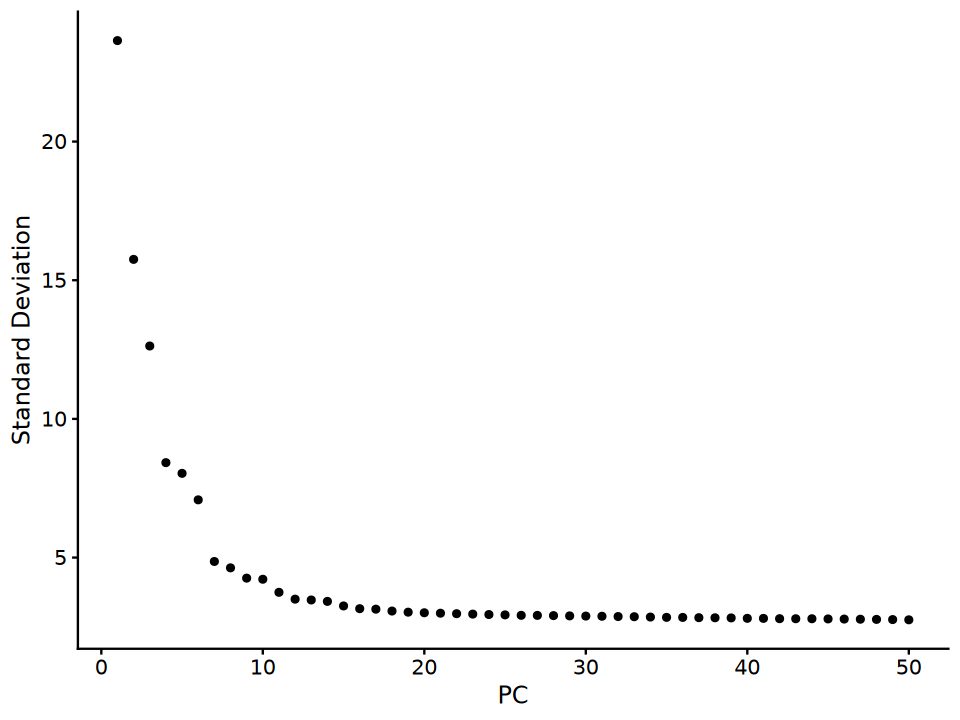

In [22]:
options(repr.plot.width = 8, repr.plot.height = 6)

ElbowPlot(visium, ndims = 50)

Based on this plot the graph seems to plateau at ~20/30. For this tutorial to save on computational time we will use 20 PC's

We also have the option to see which genes are contributing to which PC's. These can be seen below:

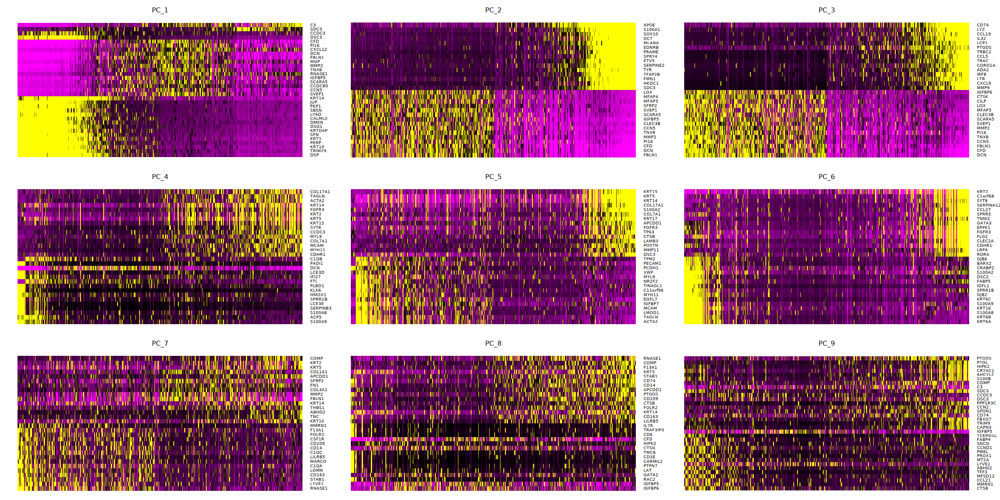

In [23]:
options(repr.plot.width = 20, repr.plot.height = 10)

DimHeatmap(visium, dims = 1:9, cells = 500, balanced = TRUE)

#### Run FindNeighbors and FindClusters

The next step is to find clusters or groups of spots that are similar based on their transcriptomic profile. Using the PC's specified above, the FindNeighbors function will use the dimensionality reduced dataset to generate a graph network which connects spots that share similar expression profiles together. Based on this network, the FindClusters function will use an iterative process to split this network into groups of similar spots, called clusters. 

The final cluster results can change based on 2 main features:
* The number of PC's/amount of information used to generate the neighbourhood graph
* The clustering resolution weight. This is a value defining the number of iterations to perform to identify clusters. The larger the number the more iterations, meaning there will be more clusters

Below we will implement these functions and use 2 different resolutions: 0.5 and 1

In [24]:
# Calculate Neighborhood Graph
visium <- FindNeighbors(visium, reduction = "pca", dims = 1:30)

# Find Clusters
visium <- FindClusters(visium, resolution = 0.5, verbose = FALSE, cluster.name = "cluster_0.5") # smaller resolution
visium <- FindClusters(visium, resolution = 1, verbose = FALSE, cluster.name = "cluster_1") # larger resolution

Computing nearest neighbor graph

Computing SNN



#### RunUMAP

The final step is to generate a UMAP. This UMAP is a way to graphically represent the refined graph generated above using FindNeighbors in a 2D format. There are some alternative visualisation plots such as t-SNE.

For more information about how a UMAP works please go here: https://alleninstitute.org/resource/what-is-a-umap/


In [25]:
visium <- RunUMAP(visium, reduction = "pca", dims = 1:30, verbose = FALSE)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”


Now we have run each of these 4 steps we can visualise the clustering results. We will also compare the difference between low vs high resolution values. 

The information for each of these functions is stored within our *Seurat Object*. We can see this below

In [26]:
visium

An object of class Seurat 
29758 features across 917 samples within 2 assays 
Active assay: SCT (14603 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: slice1

Here we can see that our PCA and UMAP results/coordinates are stored in the 'reduction' slot. 

In [27]:
head(visium@meta.data)

,orig.ident,nCount_Spatial,nFeature_Spatial,percent.mt,nCount_SCT,nFeature_SCT,cluster_0.5,seurat_clusters,cluster_1
,<fct>,<dbl>,<int>,<dbl>,<dbl>,<int>,<fct>,<fct>,<fct>
AACACGTGCATCGCAC-1,SeuratProject,980,717,1.1224490,1350,710,0,0,0
AACAGGAAGAGCATAG-1,SeuratProject,1003,715,0.5982054,1343,708,0,0,0
AACATCTAATGACCGG-1,SeuratProject,1466,1005,0.8867667,1559,998,0,0,0
AACATGCGCAAGTGAG-1,SeuratProject,2356,1688,1.1035654,2226,1661,1,1,1
AACCAGAATCAGACGT-1,SeuratProject,44942,8952,0.9078368,1953,1276,3,4,4
AACCATCGGAAGCGAC-1,SeuratProject,4309,2807,1.2299838,2773,2369,2,2,2


Additionally, the cluster labels are stored in the meta.data slot. We can see two new columns were created, one for each of our clusters. Let's plot them now:

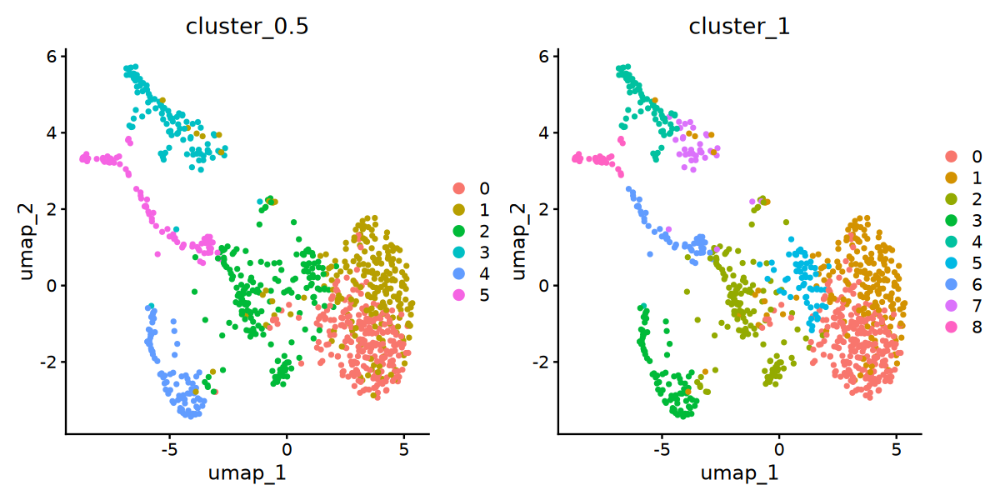

In [28]:
options(repr.plot.width = 10, repr.plot.height = 5)

DimPlot(visium, group.by = "cluster_0.5") | DimPlot(visium, group.by = "cluster_1")

We can see that the UMAP plot is the same, because the number of PC's we used was the same for both of our clusters, but the groupings of spots into clusters has changed.

Working out the optimal clusters/number of PCs to use is a game of guess and check. Often, we need to play around with the different input variables to work out the most representative results. The best way to check if these results make sense is to determine if they accurately represent our known cell types within the skin. So let's spatially plot these clusters:

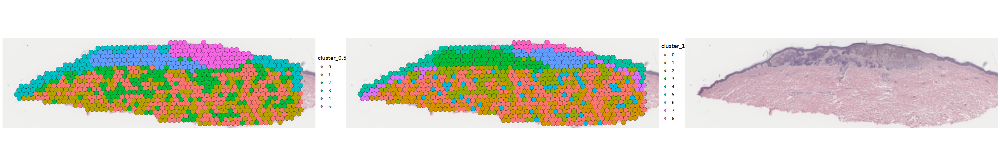

In [29]:
options(repr.plot.width = 30, repr.plot.height = 5)

SpatialDimPlot(visium, group.by = "cluster_0.5", pt.size.factor = 1.4) & theme_void() | SpatialDimPlot(visium, group.by = "cluster_1", pt.size.factor = 1.4) & theme_void()  | SpatialDimPlot(visium, group.by = "cluster_1", pt.size.factor = 0) & theme_void() + NoLegend()

We can see that our clustering results are slightly different based on the resolution used. An important note here is that cluster0 in one clustering results does not match cluster 0 in a separate clustering result. These numbers/labels are arbitrary. 

But what we can see is that the clustering using a resolution = 1 seems to do a better job at splitting this epidermal/dermal region (cluster6 and cluster9) compared to resolution = 0.5 which just represents these spots as one cluster (cluster6). 

Based on this for the rest of the script we will use a clustering resolution = 1. Now we will run clustering for the Xenium data, following the same approach.

#### Run Xenium Clustering

In the script below we have decided to use 30PCs and a resolution of 0.3. Because there are so many more cells in Xenium data then Visium, often lowering the resolution is a needed step so that we don't get excessive amounts of clusters. As a general rule we aim for about 10-15 clusters initially as this is similar to the number of general cell types we expect in this tissue type. Feel free to change the resolution and PC/dim values and see how the results change!

In [30]:
xenium <- RunPCA(xenium, npcs = 30, verbose = FALSE) # we have decided to use 30
xenium <- RunUMAP(xenium, dims = 1:30, verbose = FALSE)
xenium <- FindNeighbors(xenium, reduction = "pca", dims = 1:30, verbose = FALSE)
xenium <- FindClusters(xenium, resolution = 0.3, verbose = FALSE) #by default the name of the clusters will be 'seurat_clusters'

Again, lets visualise the results!

Warning message:
“No FOV associated with assay 'SCT', using global default FOV”


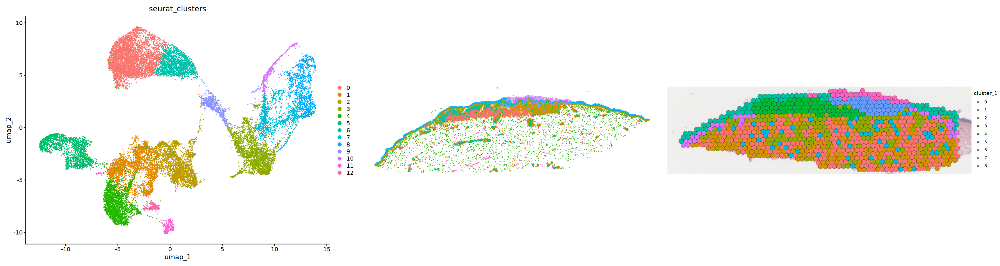

In [31]:
options(repr.plot.width = 30, repr.plot.height = 8)

DimPlot(xenium, group.by = "seurat_clusters") | ImageDimPlot(xenium, group.by = "seurat_clusters", dark.background = F) + NoLegend()  |  SpatialDimPlot(visium, group.by = "cluster_1", pt.size.factor = 1.4) & theme_void()

From the Xenium data we can see how many more cells our UMAP contains compared to the number of Cisium spots. However, the orientation/clustering patterns looks quite similar between the Visium and Xenium Data!

Let's zoom into the Xenium data to look at a region of interest

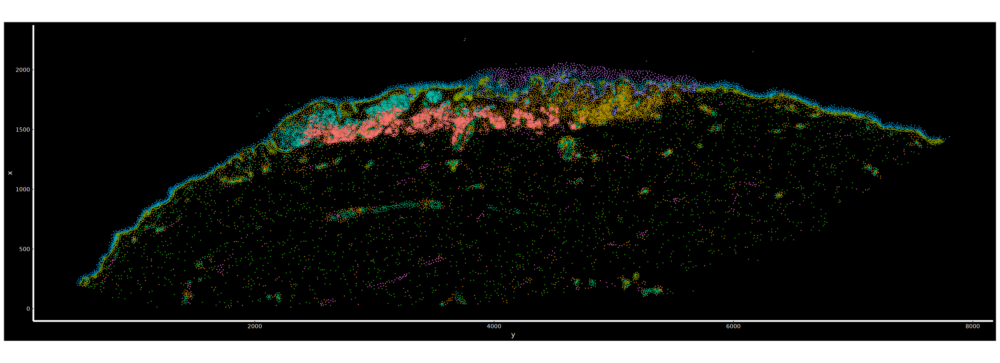

In [32]:
options(repr.plot.width = 22, repr.plot.height = 8)

ImageDimPlot(xenium, group.by = "seurat_clusters", dark.background = T, axes = T, fov = "fov") + NoLegend()

In [33]:
cropped.coords <- Crop(xenium[["fov"]], x = c(1200, 2100), y = c(3000, 5000), coords = "tissue")

In [34]:
xenium[["zoom"]] <- cropped.coords
DefaultBoundary(xenium[["zoom"]]) <- "segmentation"

Warning message:
“Key ‘Xenium_’ taken, using ‘zoom_’ instead”
Warning message:
“Adding image with unordered cells”


Warning message in brewer.pal(n = length(x = levels(x = molecules$molecule)), name = "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


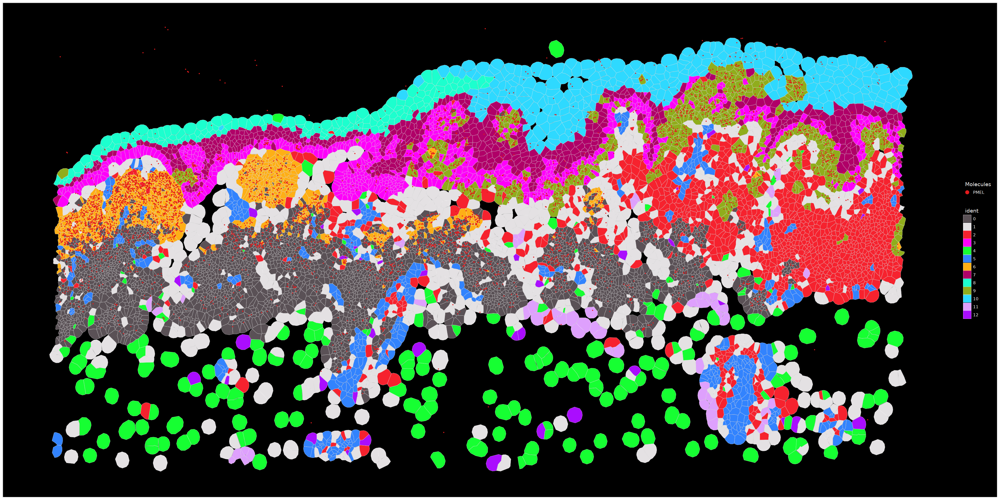

In [35]:
options(repr.plot.width = 30, repr.plot.height = 15)

ImageDimPlot(xenium, fov = "zoom", axes = F, border.color = "white", border.size = 0.1, cols = "polychrome",
    coord.fixed = FALSE, molecules = c("PMEL"), nmols = 10000)

#### Cell Typing

Cell typing our clusters is one of the most important steps in the analysis of spatial data. Often downstream analyses are performed comparing different cells in their expression of genes, ligands and receptors, interactions with other cells, and more, meaning that defining our cells is required before running any of these analyses. 

There are 3 main ways of cell typing:
* Marker Gene Approach -> Requires a curated list of genes that are specific to each cell type of interest (manually)
* Database Matching of DEGs -> Matches a list of differentially expressed genes (DEGs) for each cluster to a database
* Spot Deconvolution/Cell Label Transfer -> Uses a previously annotated single-cell RNA dataset to assign spots/cells labels based on similarities between transcriptomic profiles

Each of these methods has positives and negatives, but ideally all methods should be used to have a confident and robust cell type annotation. 


|  Method Type  | Positives       |     Negatives   | 
| :----:      |     :----              |  :----     |
| Marker Gene      | <ul><li>Uses refined/well known markers to define cells (excludes noisy genes)</li><li>Doesn't directly rely on a public/pre-established scRNA dataset</li></ul>  | <ul><li>Time Consuming</li><li> Only uses a handful of genes</li></ul>| 
| DEG Database Searching |<ul><li> Uses all significantly DEGs (>100) to identify cell type</li><li>Doesn't directly rely on a public/pre-established scRNA dataset</li></ul>  | <ul><li>Relies on a high quality database, which may not always contain your cell types of interest</li><li> Less reproducible </li></ul>| 
| Deconvolution/Label Transfer  |  <ul><li>Uses an unbiased/unsupervised approach to assign cell types </li><li>For Visium data can estimate the percentage of cell types within a spot</li></ul>  | <ul><li>Heavily reliant on a high quality scRNA dataset which may not be available publicly for all tissue types </li><li> Expensive to generate</li></ul>| 




#### Marker Gene Based Cell Typing

As this is melanoma skin data we will use a list of genes known to be specific for each cell type. To determine which clusters express these we can use a DotPlot

In [36]:
visium_markers <- list( "KC Basal"= c("KRT15", "COL17A1"),
            "KC Other"= c("KRT16", "KRT17", "KRT6A", "IVL"),
            "Melanocyte" =c("MITF","PMEL","TYR","DCT","MLANA","S100A1"),
            "T cell"= c( "CD3D","CD3E", "CD4", "CD8A"),
            "Pericytes" = c("ACTA2", "C11orf96", "MYH11"),
            "Macrophage" = c( "C1QA", "SIGLEC1", "LYVE1","CD163"),
            "Fibroblast"= c("PDGFRA", "PDGFRB", "DCN"))
      

Warning message:
“The `facets` argument of `facet_grid()` is deprecated as of ggplot2 2.2.0.
ℹ Please use the `rows` argument instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>.”


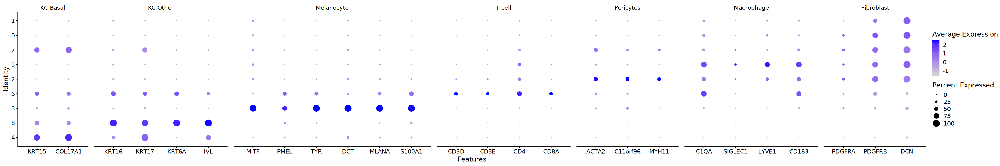

In [37]:
options(repr.plot.width = 30, repr.plot.height = 5)

DotPlot(visium, features = visium_markers, cluster.idents = T)

Based on this we can assign each of these clusters some cell type labels and then see how they a distributed spatially!

In [38]:
visium@meta.data <- visium@meta.data  %>%
  mutate(marker_annotations = case_when(
    cluster_1 == 1 ~ "Fibroblast",
    cluster_1 == 0 ~ "Fibroblast",
    cluster_1 == 7 ~ "Fibroblast",
    cluster_1 == 5 ~ "Macrophage",
    cluster_1 == 2 ~ "Pericytes",
    cluster_1 == 6 ~ "T cell",
    cluster_1 == 3 ~ "Melanocyte",
    cluster_1 == 8 ~ "KC Other", 
    cluster_1 == 4 ~ "KC Basal"
  ))

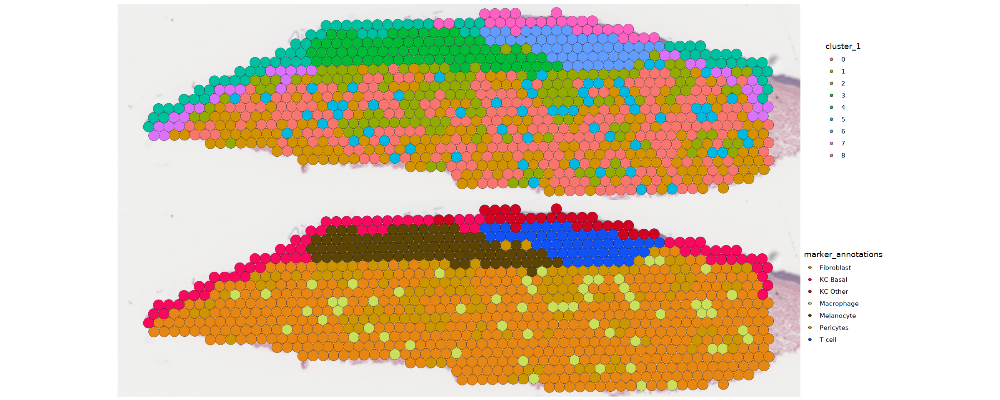

In [39]:
marker_palette <- list( "Fibroblast" = "#E68613", ## uses a custom colour palette for plotting
                       "Macrophage" = "#CAE05A",
                       "Pericytes" = "#CD9600",
                       "T cell" = "#1152F5",
                       "Melanocyte" = "#5C4403",
                       "KC Other" = "#CF0422",
                       "KC Basal" = "#F70A5D")

p1 <- SpatialDimPlot(visium, group.by = "cluster_1", pt.size.factor = 1.4) + theme_void()
p2 <- SpatialDimPlot(visium, group.by = "marker_annotations", pt.size.factor = 1.4, cols = marker_palette) + theme_void()


options(repr.plot.width = 20, repr.plot.height = 8)

p1/p2

Based on the spatial location of these annotations they look to be quite accurate!
* Melanocytes are located where the melanoma is
* KC Basal and KC other cells are located in the epidermis
* Fibroblasts, Pericytes and Macrophages make up the rest of the dermis layer
* **T cells**: It is interesting that there is a cluster of T-cells localised near the melanoma

Let's do the same for the Xenium Data 

In [40]:
xenium_genes <- list("T Cells" = c('ARHGDIB','CD3G','LCK'),
                     "Lymphatic Endothelial Cells" = c('FABP4','LYVE1','MMRN1','PROX1'),
                     "CD8_naive" = c('ALOX5AP','GATA2','KIT','RASSF8'),
                     "Macrophages" = c('C1QA','C5AR1'), 
                     "Secretory-reticular Fibroblasts" = c('FBLN1','MFAP5','MMP2','MMP27'),
                     "Melanocytes" = c('PMEL','QPCT','TFAP2B','TRPM1'),
                     "Melanoma" = c('EDNRB','MITF','MYC','PLP1'),
                     "Pericytes" = c('ACTA2','C11orf96','MYH11'),
                     "TSK_Basal" = c("LAMB3", "COL17A1"),
                     "TSK_differentiating" = c('ENAH','IL33','MAL2','RHOV'),
                     "Granular Cells" = c('KRT2','NOTCH3'),
                     "Differentiated Keratinocytes" = c('DSC1','LYPD3'))

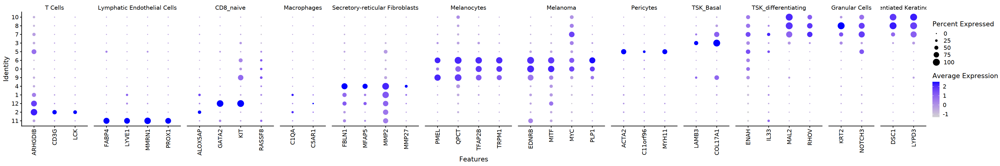

In [41]:
options(repr.plot.width = 30, repr.plot.height = 5)

DotPlot(xenium, xenium_genes, cluster.idents = T) +  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1))

In [42]:
xenium@meta.data <- xenium@meta.data  %>%
  mutate(marker_annotations = case_when(
    seurat_clusters == 2 ~ "T Cells",
    seurat_clusters == 11 ~ "Lymphatic Endothelial Cells",
    seurat_clusters == 12 ~ "CD8_naive",
    seurat_clusters == 1 ~ "Macrophages",
    seurat_clusters == 4 ~ "Secretory-reticular Fibroblasts",
    seurat_clusters == 9 ~ "Melanocytes",
    seurat_clusters == 0 ~ "Melanoma",
    seurat_clusters == 6 ~ "Melanoma", 
    seurat_clusters == 5 ~ "Pericytes",
    seurat_clusters == 3 ~ "TSK_Basal",
    seurat_clusters == 7 ~ "TSK_differentiating",
    seurat_clusters == 8 ~ "Granular Cells", 
    seurat_clusters == 10 ~ "TSK_differentiating"
  ))

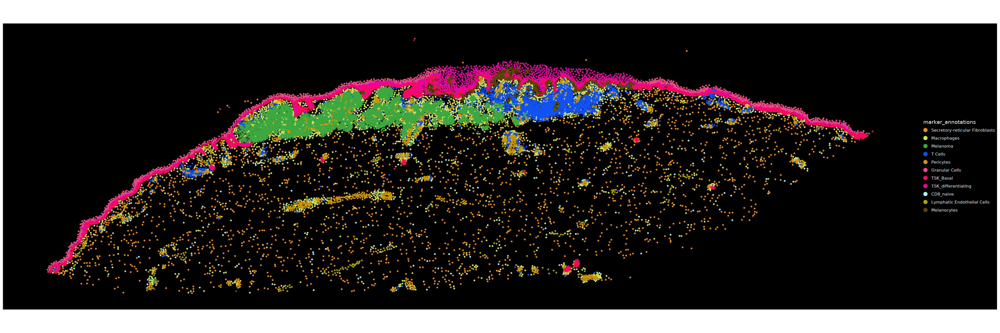

In [43]:
xenium_palatte <- list('TSK_differentiating' = "#E805A0",
                       'Differentiated Keratinocytes' = "#CF0422",
                       'TSK_differentiating' = "#FF052A", 
                       'TSK_Basal' = "#F70A5D", 
                       'Granular Cells' = "#F04A84", 
                       'CD8_naive' = "#A8F1F7",
                       'T Cells' = "#1152F5",
                       'Macrophages' = "#CAE05A",
                       'Secretory-reticular Fibroblasts' = "#E68613",
                       'Pericytes' = "#CD9600",
                       'Lymphatic Endothelial Cells' = "#ABA300",
                       "Melanoma" = "#3DA840",
                       'Melanocytes' = "#5C4403")

options(repr.plot.width = 30, repr.plot.height = 10)

ImageDimPlot(xenium, group.by = "marker_annotations", cols = xenium_palatte, fov = "fov", dark.background = T, size = 1.5)

We can see how much more detail we get from the xenium data being at single-cell resolution. We can observe some key points:
* Cell type labels are consistent between Xenium and Visium data
* With Xenium data we can define "melanocytes" vs "melanoma" cells unlike Visium
* Can see nice difference between basal and differentiating keratinocytes

#### Database Matching of DEGs

Now that we have used common marker genes to cell type let's try using some reference databases to check our DE genes between clusters. 
The database we will be using is EnrichR which can be accessed online: https://maayanlab.cloud/Enrichr/

First let's find our DEG's per cluster.

In [44]:
Idents(visium) <- "cluster_1"

cluster_markers <- FindAllMarkers(object = visium, assay = "SCT", only.pos = T) #Find significantly up-regulated genes for each cluster compared to all other clusters

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8



In [45]:
cluster_markers %>%
    group_by(cluster) %>%
        slice_head(n = 3)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
2.132837e-73,1.3404126,1.000,0.890,3.114582e-69,0,COL1A2
1.370297e-68,1.3021748,1.000,0.744,2.001044e-64,0,DCN
3.691295e-68,1.4073635,1.000,0.934,5.390399e-64,0,COL1A1
5.611289e-21,0.7666655,0.990,0.662,8.194165e-17,1,CFD
1.140967e-20,1.1248144,0.803,0.545,1.666154e-16,1,IGFBP5
1.390231e-20,0.7228050,1.000,0.890,2.030155e-16,1,SPARC
1.646998e-54,2.2540348,0.964,0.440,2.405111e-50,2,IGFBP7
1.219996e-47,2.8861666,0.681,0.145,1.781560e-43,2,EGFL7
7.856250e-46,3.9444140,0.420,0.039,1.147248e-41,2,TINAGL1


This process can be quite tedious so rather then running it, below is an example of the general process

In [46]:
#write.csv(cluster_markers, "~/Downloads/markers.csv")


the results!

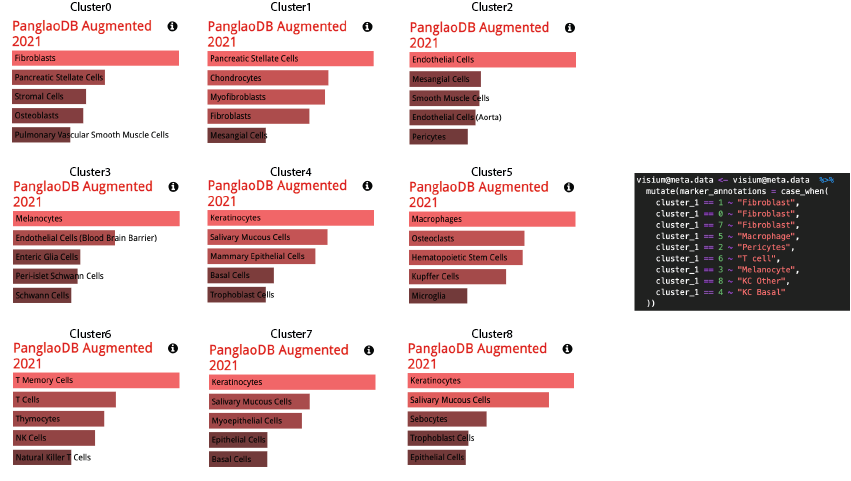

We can see that almost all of our annotations match between the DEGs database and marker based methods!

## 3. Spot Deconvolution/Cell Label Transfer

The final and most intensive way to cell type is using spot deconvolution or cell label transfer methods. The aim of these methods is to use an established and annotated scRNA data object as a source and then based on matching cells with similar transcriptional patterns (between the scRNA and Visium/Xenium query dataset), the respective cell type labels will be transferred. For spot deconvolution this method goes one step further, where for each spot the relative proportion of each cell type can be predicted based on expression profiles. 

<br>

**Deconvolution methods:**
* RCTD -> Common deconvolution technology (one of the first)
* STDeconvolve -> A reference free deconvolution method that does not require a scRNA reference
* CARD -> Uses both transcriptional and spatial information to perform spot deconvolution

Deconvolution can only be performed on non single-cell technologies such as Visium. Single cell technologies share a 1:1 ratio when using scRNA datasets so a label transfer method is used

**Label Transfer methods:**
* Seurat Anchor Transfer -> label transfer method implemented in *Seurat*
* UniCellDeconvolve -> A ML based packaged in python that can perform label transfer on an anndata object without the need for a scRNA dataset, because the model has been trained on ~10 million cells

<br>

First we will run *CARD* to deconvolve the Visium data

#### Visium Deconvolution: CARD

Below we will implement CARD, for more information please visit here: https://yma-lab.github.io/CARD/documentation/04_CARD_Example.html

<br>

First we will load our single-cell RNA melanoma dataset, and take a look at the annotations

In [47]:
## Load Visium Data
visium <- readRDS("/working/joint_projects/P3903/teaching2024-winter-qimr/data/finalised_files_to_move/visium_processed.RDS")

## Load Xenium Data
xenium <- readRDS("/working/joint_projects/P3903/teaching2024-winter-qimr/data/finalised_files_to_move/xenium_processed.RDS")

## Load scRNA Data
 scRNA <- readRDS("/working/joint_projects/P3903/teaching2024-winter-qimr/data/finalised_files_to_move/scRNA_processed.RDS")

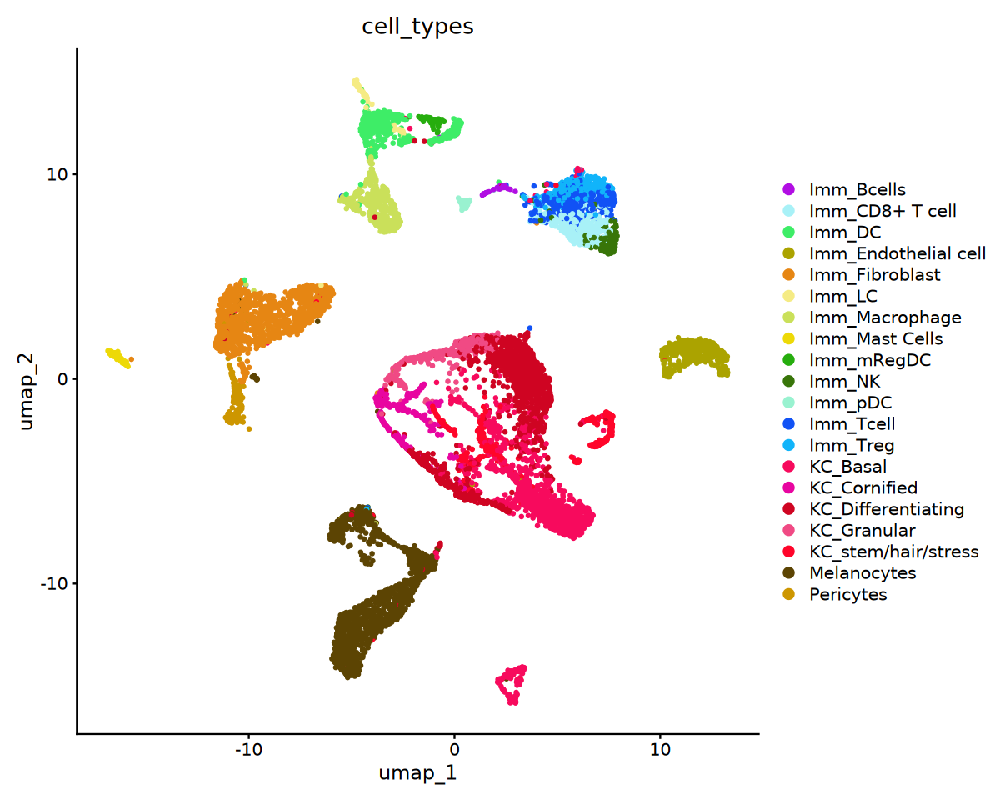

In [48]:
colour_palette <- list('KC_Cornified' = "#E805A0",
                       'KC_Differentiating' = "#CF0422",
                       'KC_stem/hair/stress' = "#FF052A", 
                       'KC_Basal' = "#F70A5D", 
                       'KC_Granular' = "#F04A84", 
                       'Imm_Bcells' = "#B10EE3", 
                       'Imm_CD8+ T cell' = "#A8F1F7",
                       'Imm_Treg' = "#11B4Fa",
                       'Imm_Tcell' = "#1152F5",
                       'Imm_pDC' = "#99F2D0",
                       'Imm_DC' = "#3EED67", 
                       'Imm_mRegDC' = "#26AD0E",
                       'Imm_NK'= "#387509", 
                       'Imm_Macrophage' = "#CAE05A", 
                       'Imm_LC' = "#F5EB84", 
                       'Imm_Mast Cells' = "#EDD907", 
                       'Imm_Fibroblast' = "#E68613",
                       'Pericytes' = "#CD9600",
                       'Imm_Endothelial cell' = "#ABA300",
                       'Melanocytes' = "#5C4403")

options(repr.plot.width = 10, repr.plot.height = 8)

DimPlot(scRNA, group.by = "cell_types", cols = colour_palette, pt.size = 0.8)

We can see that we have various immune, keratinocytes and other common skin cells annotated in this dataset. We also have melanocytes annotated which will hopefully identify the melanoma cells present in our samples. Now we can run label transfer using CARD. 

NOTE: CARD runs using raw count data and not normalised data, so we will be using data from the "@Spatial$counts" slot

In [49]:
# First we need to change the name of our coordinates to "x" and "y"
visium_coords <- GetTissueCoordinates(visium)
visium_coords$y <- max(visium_coords$imagerow) - visium_coords$imagerow + min(visium_coords$imagerow)
visium_coords$x <- visium_coords$imagecol
visium_coords <- visium_coords[c("x", "y")]

# First Create a CARD Object using the scRNA and Visium raw data counts

CARD_obj = createCARDObject(
    
	sc_count = scRNA@assays$RNA$counts,
	sc_meta = scRNA@meta.data,
	spatial_count = visium@assays$Spatial$counts,
	spatial_location = visium_coords,
	ct.varname = "cell_types",
	ct.select = unique(scRNA@meta.data$cell_types),
	sample.varname = "sample",
	minCountGene = 100,
	minCountSpot = 3) 

## QC on scRNASeq dataset! ...
## QC on spatially-resolved dataset! ...


In [50]:
# Now we can run deconvolution 

CARD_obj = CARD_deconvolution(CARD_object = CARD_obj)

## create reference matrix from scRNASeq...


Loading required package: nnls

Loading required package: TOAST

Loading required package: EpiDISH

Loading required package: limma


Attaching package: ‘limma’


The following object is masked from ‘package:BiocGenerics’:

    plotMA


Loading required package: quadprog

Registered S3 method overwritten by 'GGally':
  method from   
  +.gg   ggplot2

MuSiC v1.0.0 support SingleCellExperiment! See Tutorial: https://xuranw.github.io/MuSiC/articles/MuSiC.html

MuSiC2 for multi-condition bulk RNA-seq data is also available!

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.3 GiB”


## Select Informative Genes! ...
## Deconvolution Starts! ...
## Deconvolution Finish! ...


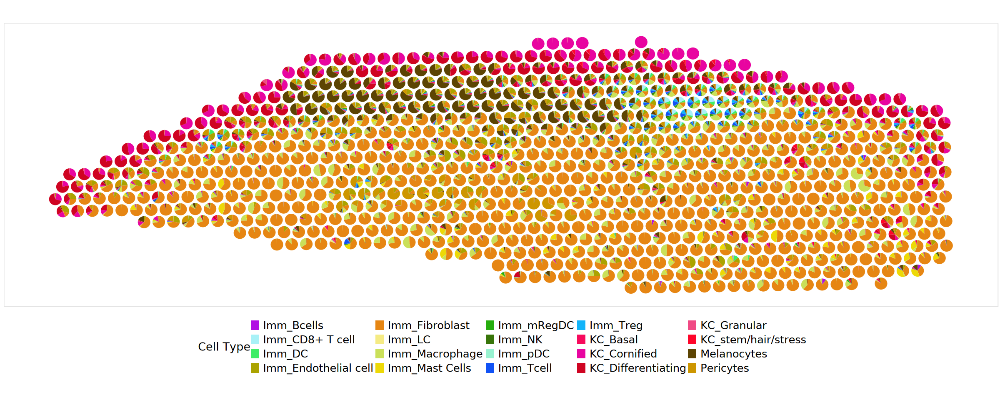

In [51]:
p1 <- CARD.visualize.pie(
	proportion = CARD_obj@Proportion_CARD,
	spatial_location = CARD_obj@spatial_location, 
 	colors = colour_palette, 
  	radius = 3.5) ### You can choose radius = NULL or your own radius number

options(repr.plot.width = 20, repr.plot.height = 8)

print(p1)

We can see that our deconvolution has worked. Here each spot is represented as a pie graph which contains the relative proportions of each cell type within that spot. We can see key spatial patterns such as our melanoma cells and immune cells. Also we can see the different layers of Keratinocytes in the epidermis. 

Lets look at the raw data table which contains this information:

In [52]:
head(CARD_obj@Proportion_CARD)

# If we need to save this we can by running the code below
#write.csv(CARD_obj@Proportion_CARD, "~Downloads/visium_decon.csv")

,KC_Cornified,KC_Differentiating,Imm_CD8+ T cell,KC_stem/hair/stress,Imm_Treg,Imm_pDC,Imm_Tcell,Imm_NK,Imm_Fibroblast,Imm_DC,KC_Basal,Melanocytes,Imm_Endothelial cell,KC_Granular,Imm_Macrophage,Imm_Bcells,Pericytes,Imm_Mast Cells,Imm_mRegDC,Imm_LC
AACACGTGCATCGCAC-1,0.0001743891,9.709853e-05,2.687468e-05,0.0001321210,4.987745e-05,3.910269e-06,1.417862e-04,0.0001688803,0.9054021,1.407047e-04,2.348137e-05,0.0007674506,0.0033353396,4.000937e-06,0.005032089,3.256583e-06,2.801896e-04,0.0793447792,0.004858785,1.285766e-05
AACAGGAAGAGCATAG-1,0.0004258617,2.509822e-05,2.887655e-05,0.0005921353,1.964446e-05,6.285850e-05,9.581879e-05,0.0001488944,0.9382010,9.083538e-05,2.129855e-05,0.0005625911,0.0001493082,3.000229e-06,0.035067626,2.460514e-04,6.317264e-05,0.0204847979,0.003585303,1.258560e-04
AACATCTAATGACCGG-1,0.0004774220,1.880430e-03,3.426454e-04,0.0001256045,6.463540e-04,4.803688e-05,2.902727e-04,0.0002031760,0.8805079,1.043613e-04,7.538627e-05,0.0066395238,0.0057249933,5.301467e-05,0.100708234,2.815790e-04,1.721622e-04,0.0004331408,0.001278760,7.027083e-06
AACATGCGCAAGTGAG-1,0.0287296029,1.514833e-01,5.103523e-04,0.1038670540,4.000098e-04,1.234111e-03,1.490239e-03,0.0012694032,0.5843740,7.004899e-03,1.452185e-02,0.0103403766,0.0445649572,4.491041e-03,0.010532591,4.532587e-04,1.305108e-03,0.0252577136,0.002426610,5.743549e-03
AACCAGAATCAGACGT-1,0.0735785239,7.291555e-01,6.591522e-04,0.0072951117,6.676203e-04,7.366913e-04,6.671188e-04,0.0010711772,0.0289846,2.152916e-03,1.098773e-01,0.0170373629,0.0154925469,3.438838e-04,0.001584751,1.786450e-04,5.739132e-03,0.0005777048,0.002307962,1.892285e-03
AACCATCGGAAGCGAC-1,0.0380456753,2.048018e-01,3.160783e-03,0.1767208508,1.680661e-03,6.021406e-03,5.368246e-03,0.0024965846,0.2107133,2.843035e-03,8.292832e-02,0.0228927940,0.1401235930,9.810109e-03,0.017864808,2.781025e-03,4.757020e-02,0.0038193412,0.017324403,3.033056e-03


We can also look at the relative locations of each cell type individually

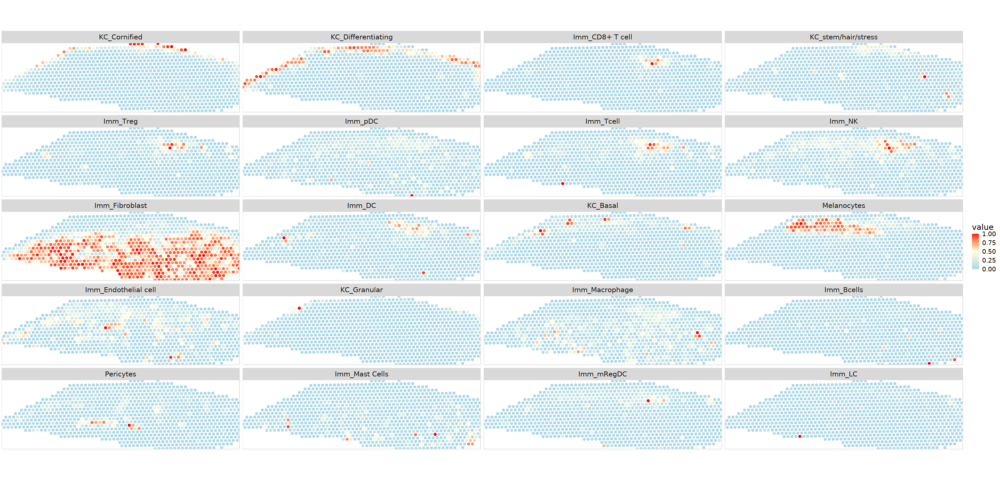

In [53]:
p2 <- CARD.visualize.prop(
	proportion = CARD_obj@Proportion_CARD,        
	spatial_location = CARD_obj@spatial_location, 
	ct.visualize = unique(scRNA@meta.data$cell_types),                 ### selected cell types to visualize
	colors = c("lightblue","lightyellow","red"), ### if not provide, we will use the default colors
	NumCols = 4,                                 ### number of columns in the figure panel
        pointSize = 1.5)                             ### point size in ggplot2 scatterplot  


options(repr.plot.width = 25, repr.plot.height = 12)

print(p2)

There are some addition ways of visualising the data, if you would like to try some please visit here: https://yma-lab.github.io/CARD/documentation/04_CARD_Example.html

#### Xenium Label Transfer

Now we will run label transfer using the same scRNA dataset on our Xenium data. Here we will use SCTransformed data from both the scRNA and Xenium objects. 

First we will find the common genes between the reference (scRNA) and query (Xenium) datasets

In [54]:
DefaultAssay(scRNA) <- "SCT"
DefaultAssay(xenium) <- "SCT"

In [55]:
common_genes <- intersect(rownames(scRNA), ### Uses only genes which are shared between the reference and xenium datasets
                        rownames(xenium))


cat("There are ", length(common_genes), " common genes shared between the scRNA and Xenium datasets")

There are  250  common genes shared between the scRNA and Xenium datasets

Next we will find transfer anchors. These anchors are essentially pairs of cells between the two datasets that have been identified by the algorithm as being highly similar based on their expression profiles. These archors serve as a point of correspondence between datasets allowing for their alignment and thus transfer of cell labels/information.

For more information about the underlying methods used here please go to: https://doi.org/10.1016/j.cell.2019.05.031

In [56]:
anchors <- FindTransferAnchors(reference = scRNA, query = xenium, features = common_genes, verbose = FALSE)

Warning message in ValidateParams_FindTransferAnchors(reference = reference, query = query, :
“Both reference and query assays have been processed with SCTransform.Setting normalization.method = 'SCT' and continuing.”
Warning message:
“No layers found matching search pattern provided”


Now that we have our anchors we can transfer the labels onto our xenium data! We need to specify the location of these labels, where in our case they are stored in the "cell_types" column of our @meta.data

In [57]:
transfered_labels <- TransferData(anchorset = anchors,
                                              refdata = scRNA$cell_types,  
                                              weight.reduction = xenium[["pca"]], 
                                              dims = 1:30, verbose = FALSE) 

xenium$cell_types <- transfered_labels$predicted.id #predicted.id is the top most likely label for this cell

In [58]:
xenium$cell_types <- transfered_labels$predicted.id 

Lets look at the results!

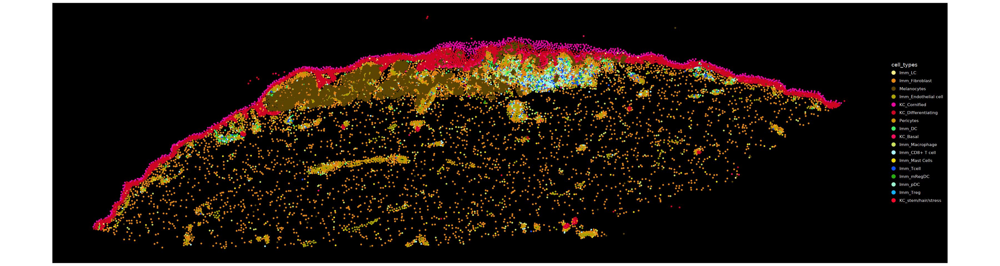

In [59]:
options(repr.plot.width = 30, repr.plot.height = 8)
        
ImageDimPlot(xenium, group.by = "cell_types", fov = "fov", cols = colour_palette, size = 1.5)

We can see similar to before we have really nice layers of keratinocytes in our epidermis. Additionally we can see our melanoma cells have been labelled as melanocytes, and we were able to identify this cluster of immune cells next to the melanoma region. Based on these three approaches we can confidently identify each cell type within both our visium and xenium samples.

<br>
Lets check that zoomed in region again

Warning message in brewer.pal(n = length(x = levels(x = molecules$molecule)), name = "Set1"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


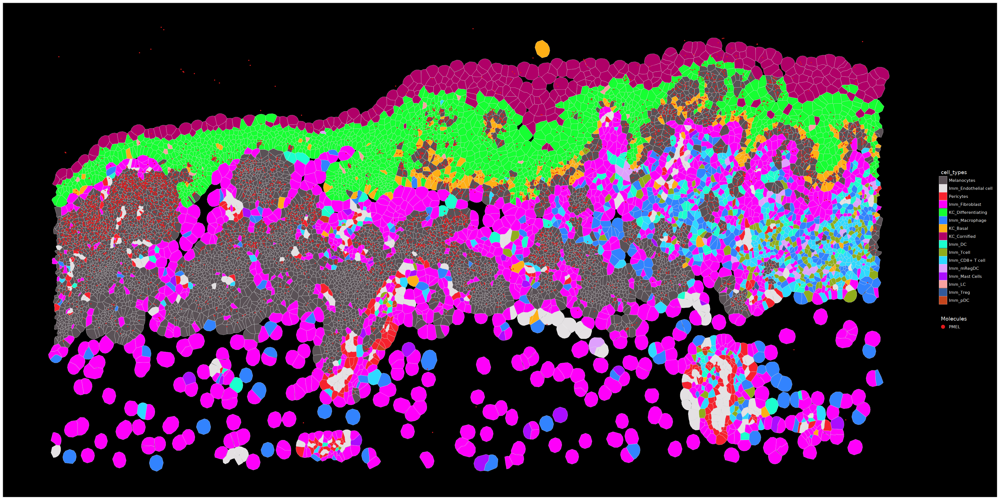

In [60]:
options(repr.plot.width = 30, repr.plot.height = 15)

ImageDimPlot(xenium, fov = "zoom", group.by = "cell_types", axes = F, border.color = "white", border.size = 0.1, cols = "polychrome",
    coord.fixed = FALSE, molecules = c("PMEL"), nmols = 10000)

Now that we have our cell types we are able to perform many more downstream analyses to answer various biological questions!

If you have any more questions please feel free to contact the author: uqacause@uq.edu.au